## Часть первая: перенос стиля при помощи pix2pix

В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired data). Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов
домов.

Датасет можно скачать [здесь](http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz) (и во многих других местах, должно быть ~29 мегабайт).

В первой части подразумевается реализация pix2pix архитектуры, т.е. генератора и дискриминатора, которые получают на вход условие в виде изображения исходного стиля (подробнее см. лекцию и собственно [Isola et al., 2016](https://arxiv.org/pdf/1611.07004.pdf))

### Download data

In [1]:
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz

!tar xopf facades.tar.gz

--2022-12-12 23:07:43--  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30168306 (29M) [application/x-gzip]
Saving to: ‘facades.tar.gz’

facades.tar.gz      100%[===================>]  28.77M  1.37MB/s    in 25s     

2022-12-12 23:08:08 (1.17 MB/s) - ‘facades.tar.gz’ saved [30168306/30168306]



In [2]:
from glob import glob
import itertools
import random
import time

import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from IPython.display import display

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset

from PIL import Image, ImageEnhance
from torchvision import transforms, utils

### Prepare dataset

In [3]:
class FacadesDataset(Dataset):
    
    def __init__(self, folder='facades/train', mode_train=True):
        self.folder = folder
        self.files = sorted(glob(self.folder + '/*.jpg'));
        self.data_transforms = transforms.Compose([
            transforms.ToTensor(),
            ])
        self.mode_train = mode_train
        
    def __getitem__(self, idx):
        imgs = Image.open(self.files[idx]).convert("RGB")

        # crop order: left, top, right, bottom
        img_from = imgs.crop((256, 0, 512, 256))
        img_to = imgs.crop((0, 0, 256, 256))
            
        if self.mode_train:
            # mirroring
            if random.random() < 0.5:
                img_from = img_from.transpose(Image.FLIP_LEFT_RIGHT)
                img_to = img_to.transpose(Image.FLIP_LEFT_RIGHT)

            # Adjust Image Brightness
            if random.random() < 0.5:
                brightness_factor = random.random() + 0.5

                enhancer_from = ImageEnhance.Brightness(img_from)
                img_from = enhancer_from.enhance(brightness_factor)
                
                enhancer_to = ImageEnhance.Brightness(img_to)
                img_to = enhancer_to.enhance(brightness_factor)

            # Adjust Image Contrast
            if random.random() < 0.5:
                contrast_factor = random.random() + 0.5

                enhancer_from = ImageEnhance.Contrast(img_from)
                img_from = enhancer_from.enhance(contrast_factor)
                
                enhancer_to = ImageEnhance.Contrast(img_to)
                img_to = enhancer_to.enhance(contrast_factor)

        img_from = self.data_transforms(img_from)
        img_to = self.data_transforms(img_to) 

        return img_from, img_to    
        
    def __len__(self):
        return len(self.files)

In [4]:
TRAIN_BATCH_SIZE = 32
VAL_BATCH_SIZE = 32

data_transforms = transforms.Compose([
    transforms.ToTensor(),
])

train_dataset = FacadesDataset(folder='facades/train', mode_train=True)

train_dataloader = torch.utils.data.DataLoader(
    train_dataset, 
    batch_size=TRAIN_BATCH_SIZE, 
    shuffle=True
)

val_dataset = FacadesDataset(folder='facades/test', mode_train=False)

val_dataloader = torch.utils.data.DataLoader(
    val_dataset, 
    batch_size=VAL_BATCH_SIZE, 
    shuffle=False
)

### Model

In [5]:
def conv_layer_encoder(in_challels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_challels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
    )

def conv_layer_decoder(in_challels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_challels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.ReLU(inplace=True),
        nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.ReLU(inplace=True),
    )

class UnetGenerator(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv_down1 = conv_layer_encoder(3, 64)
        self.conv_down2 = conv_layer_encoder(64, 128)
        self.conv_down3 = conv_layer_encoder(128, 256)
        self.conv_down4 = conv_layer_encoder(256, 512)
        self.conv_down5 = conv_layer_encoder(512, 1024)
        
        self.conv_up1 = conv_layer_decoder(512 + 1024, 512)
        self.conv_up2 = conv_layer_decoder(256 + 512, 256)
        self.conv_up3 = conv_layer_decoder(128 + 256, 128)
        self.conv_up4 = conv_layer_decoder(64 + 128, 64)
        self.conv_up5 = nn.Conv2d(64, 3, kernel_size=1)
        
        self.down = nn.MaxPool2d(kernel_size=2)
        self.up = nn.Upsample(scale_factor=2, mode='bicubic', align_corners=True)
        
        
    def forward(self, x):
        out1 = self.conv_down1(x)
        out1 = F.dropout(out1)
        x = self.down(out1)
        
        out2 = self.conv_down2(x)
        out2 = F.dropout(out2)
        x = self.down(out2)
        
        out3 = self.conv_down3(x)
        out3 = F.dropout(out3)
        x = self.down(out3)

        out4 = self.conv_down4(x)
        out4 = F.dropout(out4)
        x = self.down(out4)
        
        x = self.conv_down5(x)
        
        x = self.up(x)    
        x = torch.cat([x, out4], dim=1)
        x = self.conv_up1(x)
        
        x = self.up(x)        
        x = torch.cat([x, out3], dim=1)
        x = self.conv_up2(x)
        
        x = self.up(x)        
        x = torch.cat([x, out2], dim=1)
        x = self.conv_up3(x)

        x = self.up(x)        
        x = torch.cat([x, out1], dim=1)
        x = self.conv_up4(x)
        
        x = self.conv_up5(x)
        x = torch.sigmoid(x)
        return x
   
        
class Discriminator(nn.Module):
    def __init__(self, is_single=False):
        super().__init__()
        self.is_single = is_single
        self.conv_down1 = conv_layer_encoder(3 if is_single else 6, 64)
        self.conv_down2 = conv_layer_encoder(64, 128)
        self.conv_down3 = conv_layer_encoder(128, 256)
        self.conv_down4 = conv_layer_encoder(256, 512)
        self.down = nn.MaxPool2d(kernel_size=2)
        
        self.pooling = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512, 2)
        
    def forward(self, condition, x=None):
        if self.is_single:
            x = condition
        else:
            x = torch.cat([condition, x], dim=1)
        
        x = self.conv_down1(x)
        x = self.down(x)
        x = F.dropout(x)
        
        x = self.conv_down2(x)
        x = self.down(x)
        x = F.dropout(x)
        
        x = self.conv_down3(x)
        x = self.down(x)
        
        x = self.conv_down4(x)
        x = self.down(x) 
        
        x = self.pooling(x)
        x = x.squeeze(-1).squeeze(-1) 
        x = self.fc(x)

        return x

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight, 0.0, 0.02)

In [7]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

if device.type == 'cuda':
    print(torch.cuda.get_device_name(0))

A100-SXM4-40GB


In [8]:
G = UnetGenerator().to(device)
D = Discriminator().to(device)

G.apply(weights_init);
D.apply(weights_init);

In [9]:
G_optim = torch.optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))
G_scheduler = torch.optim.lr_scheduler.StepLR(G_optim, 200)
D_optim = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
D_scheduler = torch.optim.lr_scheduler.StepLR(D_optim, 200)

### Train pix2pix

Epoch: 0, time spent: 28.22169017791748


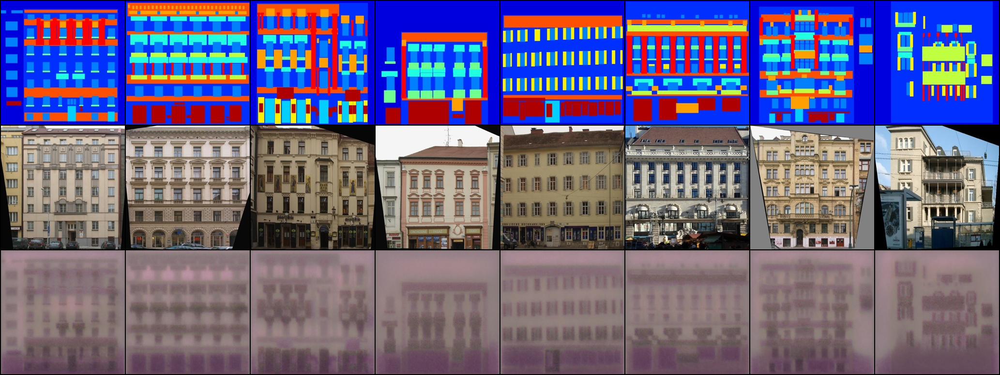

Epoch: 20, time spent: 403.08889389038086, G loss: 20.782100677490234, D loss: 0.6087999939918518


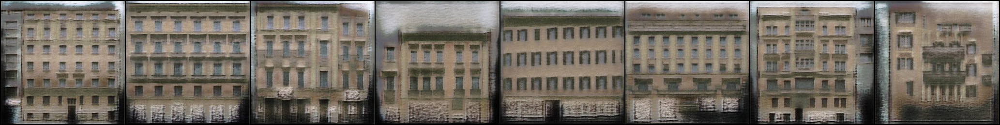

Epoch: 40, time spent: 402.43137073516846, G loss: 20.5531005859375, D loss: 0.39340001344680786


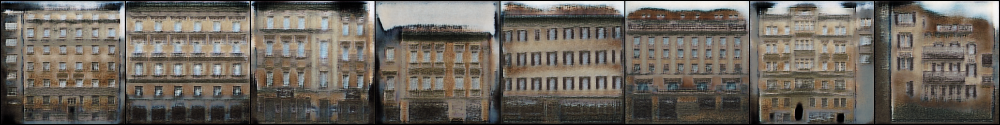

Epoch: 60, time spent: 402.7473678588867, G loss: 19.878299713134766, D loss: 0.4034999907016754


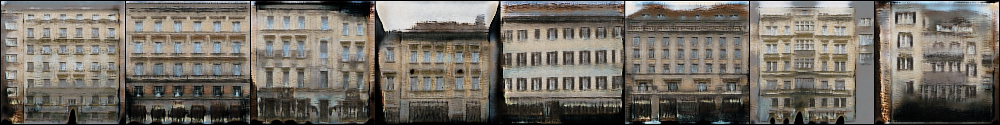

Epoch: 80, time spent: 402.74913120269775, G loss: 19.178800582885742, D loss: 0.4027000069618225


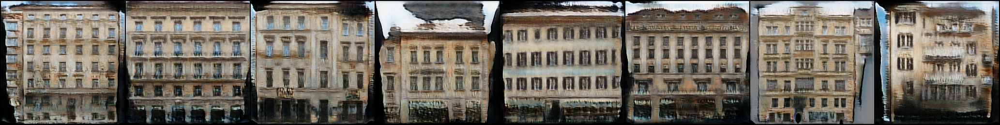

Epoch: 100, time spent: 403.0521152019501, G loss: 18.51930046081543, D loss: 0.40529999136924744


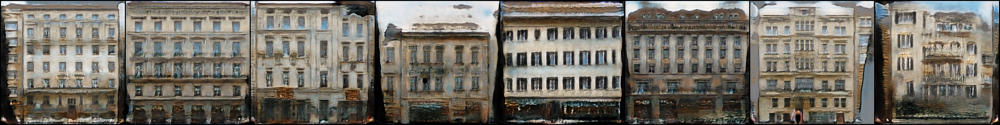

Epoch: 120, time spent: 401.6022186279297, G loss: 17.930299758911133, D loss: 0.40709999203681946


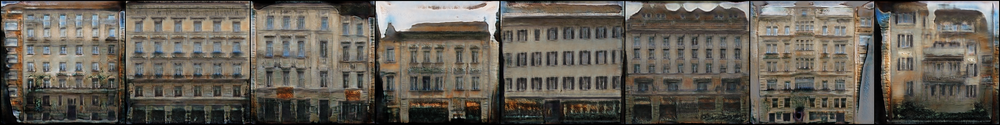

Epoch: 140, time spent: 401.3178231716156, G loss: 17.48240089416504, D loss: 0.40529999136924744


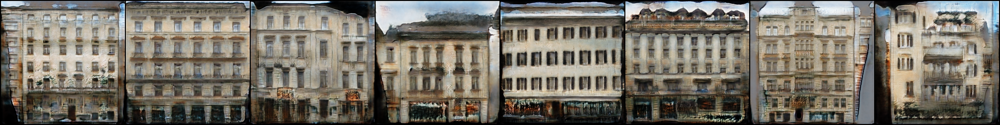

Epoch: 160, time spent: 401.5384759902954, G loss: 17.096200942993164, D loss: 0.40209999680519104


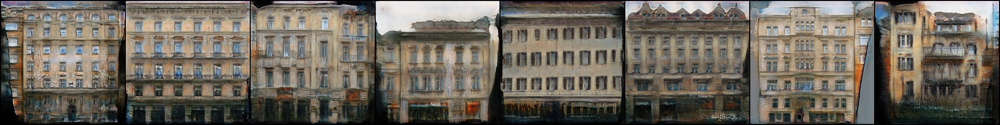

Epoch: 180, time spent: 401.5218789577484, G loss: 16.797800064086914, D loss: 0.39629998803138733


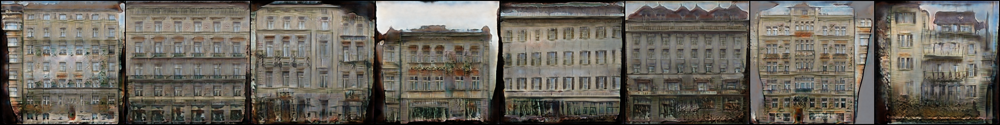

Epoch: 200, time spent: 400.8133897781372, G loss: 16.57069969177246, D loss: 0.38920000195503235


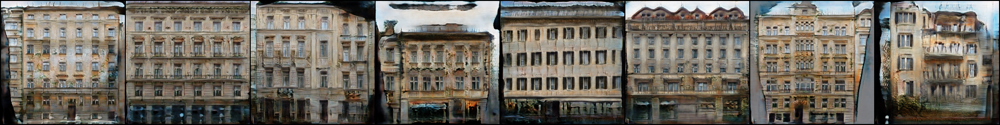

CPU times: user 1h 38min 27s, sys: 3min 18s, total: 1h 41min 46s
Wall time: 1h 7min 29s


In [10]:
%%time

import numpy as np

N_IMAGES_TO_DISPLAY = 8
PRINT_EVERY = 20
LAMBDA_G_L1 = 100

D_hist = []
G_hist = []

D_fake_loss_list = []
D_real_loss_list = []
D_loss_list = []

G_cross_entropy_list = []
G_l1_list = []
G_loss_list = []


start_time = time.time()
start_display = True

for epoch in range(201):

    inner_D_fake_loss_list = []
    inner_D_real_loss_list = []
    inner_D_loss_list = []

    inner_G_cross_entropy_list = []
    inner_G_l1_list = []
    inner_G_loss_list = []

    # to see metrics during train
    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), leave=False, position=0)

    for i, batch in pbar:

        condition, img_real = batch
        condition = condition.to(device)
        img_real = img_real.to(device)

        G.eval()
        D.train()
        D_optim.zero_grad()

        img_fake = G(condition)
        logits_fake = D(condition, img_fake)
        logits_real = D(condition, img_real)
        D_fake_loss = F.cross_entropy(logits_fake, torch.zeros(logits_fake.shape[0]).long().to(device))
        D_real_loss = F.cross_entropy(logits_real, torch.ones(logits_fake.shape[0]).long().to(device))
        D_loss = (D_fake_loss + D_real_loss) * 0.5
        
        
        D_loss.backward()
        D_optim.step()
        D_hist.append(D_loss.item())

        inner_D_fake_loss_list.append(D_fake_loss.cpu().detach().numpy())
        inner_D_real_loss_list.append(D_real_loss.cpu().detach().numpy())
        inner_D_loss_list.append(D_loss.cpu().detach().numpy())
        
        G.train()
        D.eval()
        G_optim.zero_grad()

        img_fake = G(condition)
        logits_fake = D(condition, img_fake)
        G_cross_entropy = F.cross_entropy(logits_fake, torch.ones(logits_fake.shape[0]).long().to(device))
        G_l1 = F.l1_loss(img_fake, img_real) * LAMBDA_G_L1
        G_loss = G_cross_entropy + G_l1
        
        G_loss.backward()
        G_optim.step()

        inner_G_cross_entropy_list.append(G_cross_entropy.cpu().detach().numpy())
        inner_G_l1_list.append(G_l1.cpu().detach().numpy())
        inner_G_loss_list.append(G_loss.cpu().detach().numpy())
        
        G_hist.append(G_loss.item())

        pbar.set_postfix({
            'D_loss': D_hist[-1],
            'G_loss': G_hist[-1],
            'G_cross_entropy': G_cross_entropy.item(),
            'G_l1': G_l1.item()
        })

    G_scheduler.step()
    D_scheduler.step()

    D_fake_loss_list.append(np.mean(inner_D_fake_loss_list))
    D_real_loss_list.append(np.mean(inner_D_real_loss_list))
    D_loss_list.append(np.mean(inner_D_loss_list))

    G_cross_entropy_list.append(np.mean(inner_G_cross_entropy_list))
    G_l1_list.append(np.mean(inner_G_l1_list))
    G_loss_list.append(np.mean(inner_G_loss_list))

    if epoch % PRINT_EVERY == 0:

        G.train() 
        if epoch > 0:
            print(f'Epoch: {epoch}, time spent: {time.time() - start_time}, G loss: {round(np.mean(G_loss_list[:-PRINT_EVERY]), 4)}, D loss: {round(np.mean(D_loss_list[:-PRINT_EVERY]), 4)}')
        else:
            print(f'Epoch: {epoch}, time spent: {time.time() - start_time}')

        start_time = time.time()

        for val_condition, val_img_real in val_dataloader:

            val_condition = val_condition[:N_IMAGES_TO_DISPLAY]
            val_img_real = val_img_real[:N_IMAGES_TO_DISPLAY]

            val_condition = val_condition.to(device)
            val_img_fake = G(val_condition).cpu().detach()

            if start_display:
                img_to_show = torch.cat([val_condition.cpu(), val_img_real, val_img_fake], dim=0)
                start_display = False
            else:
                img_to_show = val_img_fake
            
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break

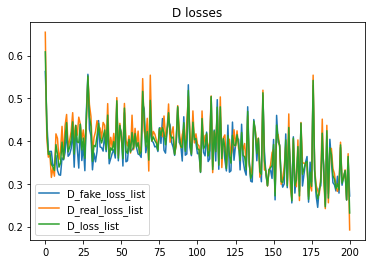

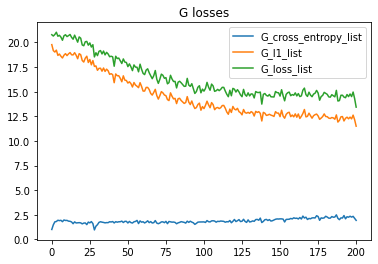

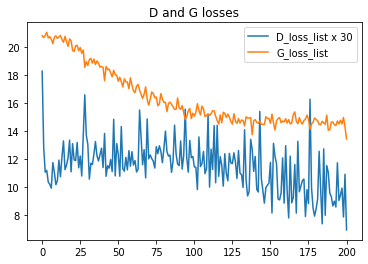

In [11]:
def plot_metrics():
    plt.title("D losses")
    plt.plot(D_fake_loss_list, label='D_fake_loss_list')
    plt.plot(D_real_loss_list, label='D_real_loss_list')
    plt.plot(D_loss_list, label='D_loss_list')
    plt.legend()
    plt.show()

    plt.title("G losses")
    plt.plot(G_cross_entropy_list, label='G_cross_entropy_list')
    plt.plot(G_l1_list, label='G_l1_list')
    plt.plot(G_loss_list, label='G_loss_list')
    plt.legend()
    plt.show()

    plt.title("D and G losses")
    plt.plot(np.array(D_loss_list)*30, label='D_loss_list x 30')
    plt.plot(G_loss_list, label='G_loss_list')
    plt.legend()
    plt.show()

plot_metrics()

## Часть вторая: добавим циклы

Вторая часть -- реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом (подробнее см. лекцию и собственно [Zhu et al., 2017](https://arxiv.org/pdf/1703.10593.pdf))

### Prepare dataset

In [10]:
TRAIN_BATCH_SIZE = 16
VAL_BATCH_SIZE = 16

data_transforms = transforms.Compose([
    transforms.ToTensor(),
])

train_dataset = FacadesDataset(folder='facades/train', mode_train=True)

train_dataloader = torch.utils.data.DataLoader(
    train_dataset, 
    batch_size=TRAIN_BATCH_SIZE, 
    shuffle=True
)

val_dataset = FacadesDataset(folder='facades/test', mode_train=False)

val_dataloader = torch.utils.data.DataLoader(
    val_dataset, 
    batch_size=VAL_BATCH_SIZE, 
    shuffle=False
)

### Prepare model

In [8]:
Gx = UnetGenerator().to(device)
Gy = UnetGenerator().to(device)
Dx = Discriminator(is_single=True).to(device)
Dy = Discriminator(is_single=True).to(device)

In [9]:
G_optim = torch.optim.Adam(itertools.chain(Gx.parameters(), Gy.parameters()), lr=0.0002, betas=(0.5, 0.999))
D_optim = torch.optim.Adam(itertools.chain(Dx.parameters(), Dy.parameters()), lr=0.0002, betas=(0.5, 0.999))

### Train CycleGAN

Epoch: 0, time spent: 60.10070180892944


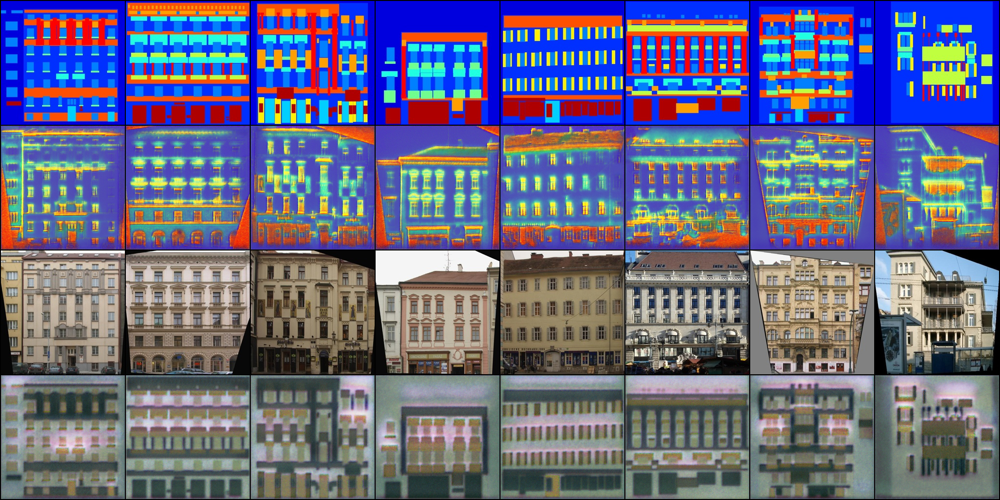

Epoch: 10, time spent: 580.9564442634583, G loss: 9.309300422668457, D loss: 1.1881999969482422


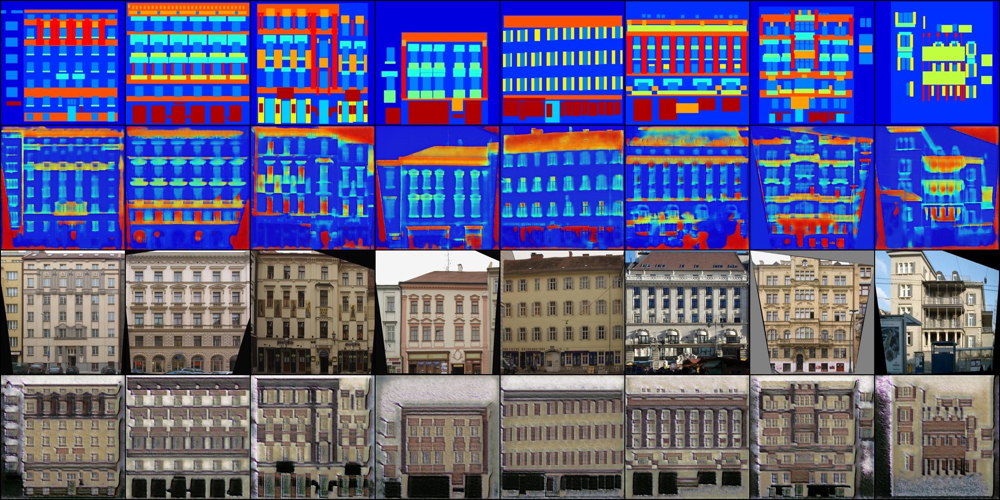

Epoch: 20, time spent: 521.3789718151093, G loss: 8.582500457763672, D loss: 0.9656000137329102


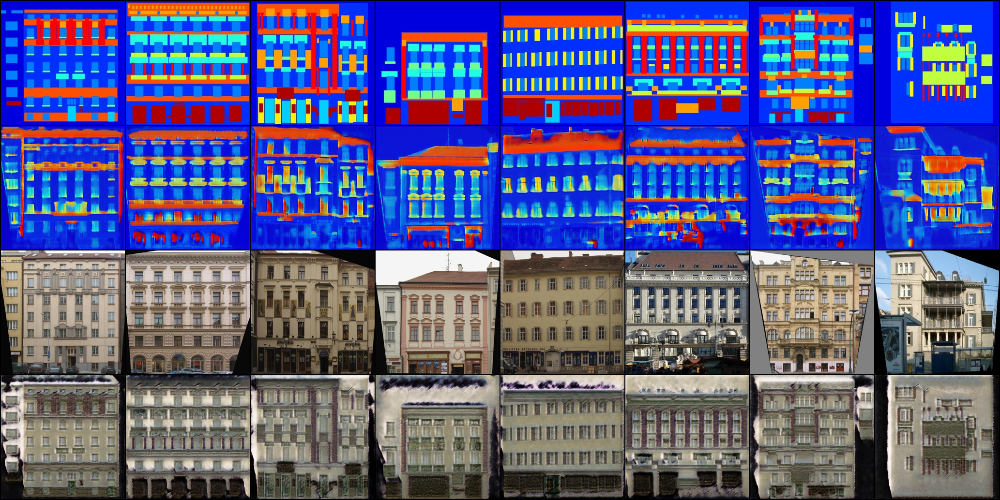

Epoch: 30, time spent: 520.8967854976654, G loss: 8.411700248718262, D loss: 0.9417999982833862


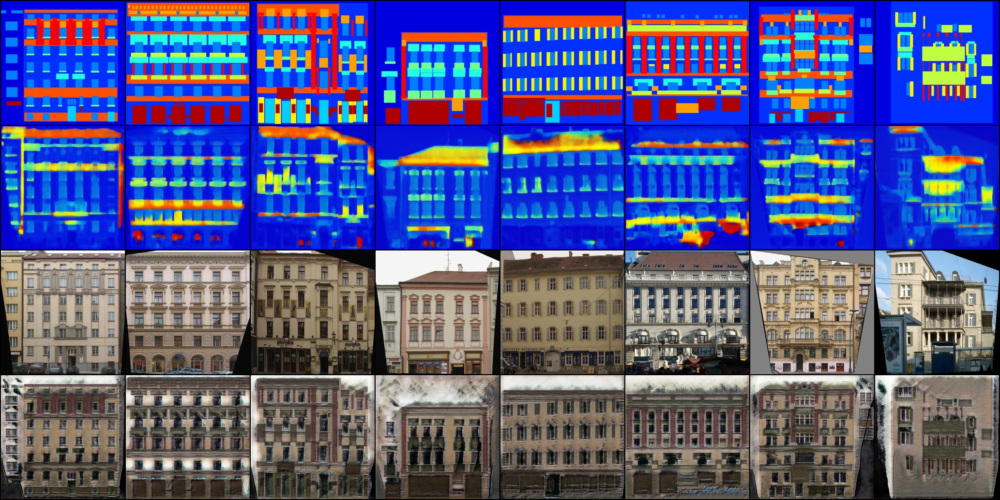

Epoch: 40, time spent: 521.0022141933441, G loss: 8.491000175476074, D loss: 0.921999990940094


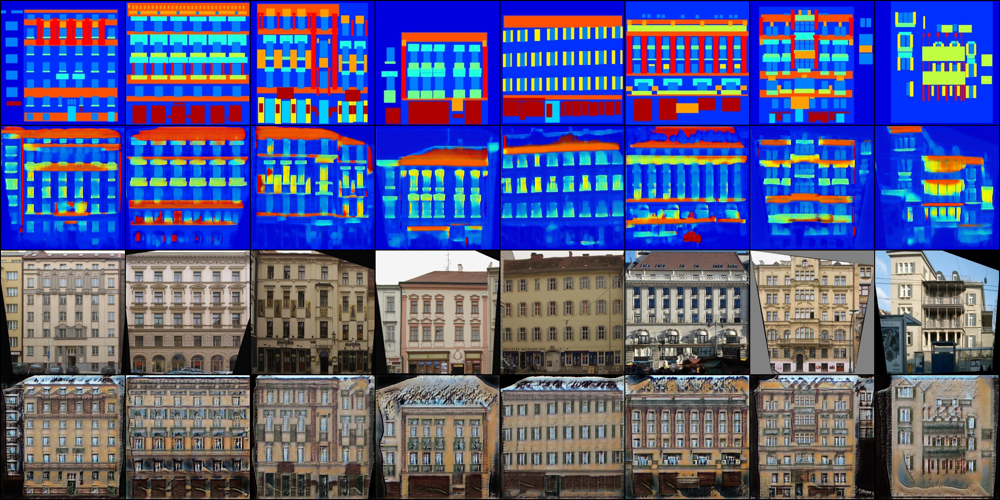

Epoch: 50, time spent: 521.0491781234741, G loss: 8.550399780273438, D loss: 0.911899983882904


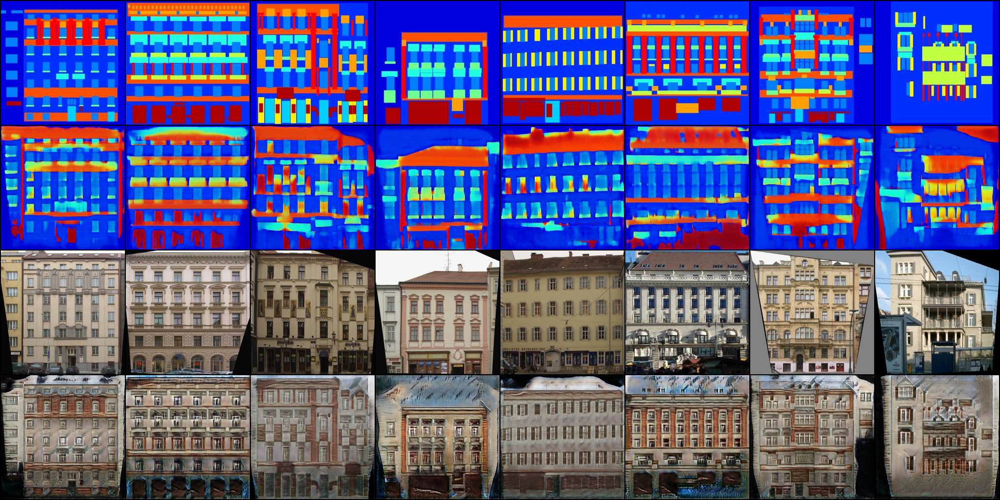

CPU times: user 40min 16s, sys: 13min 5s, total: 53min 21s
Wall time: 44min 26s


In [11]:
%%time

PRINT_EVERY = 10
N_IMAGES_TO_DISPLAY = 8

# statistics for plots
Dx_fake_loss_list = []
Dx_real_loss_list = []
Dx_loss_list = []

Dy_fake_loss_list = []
Dy_real_loss_list = []
Dy_loss_list = []

D_loss_list = []

Gx_cross_entropy_list = []
Gy_cross_entropy_list = []
G_identity_rec_list = []
G_identity_list = []

G_loss_list = []


start_time = time.time()

for epoch in range(51):

    inner_Dx_fake_loss_list = []
    inner_Dx_real_loss_list = []
    inner_Dx_loss_list = []

    inner_Dy_fake_loss_list = []
    inner_Dy_real_loss_list = []
    inner_Dy_loss_list = []

    inner_D_loss_list = []


    inner_Gx_cross_entropy_list = []
    inner_Gy_cross_entropy_list = []
    inner_G_identity_rec_list = []
    inner_G_identity_list = []

    inner_G_loss_list = []

    # to see metrics during train
    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), leave=False, position=0)
    for i, batch in pbar:

        X, Y = batch
        X = X.to(device)
        Y = Y.to(device)

        Gx.eval()
        Gy.eval()
        Dx.train()
        Dy.train()
        D_optim.zero_grad()
 
        Y_fake = Gx(X)
        X_fake = Gy(Y)

        X_logits_fake = Dx(X_fake)
        X_logits_real = Dx(X)

        Y_logits_fake = Dy(Y_fake)
        Y_logits_real = Dy(Y)

        Dx_fake_loss = F.cross_entropy(X_logits_fake, torch.zeros(X_logits_fake.shape[0]).long().to(device))
        Dx_real_loss = F.cross_entropy(X_logits_real, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Dx_loss = (Dx_fake_loss + Dx_real_loss) * 0.5

        Dy_fake_loss = F.cross_entropy(Y_logits_fake, torch.zeros(Y_logits_fake.shape[0]).long().to(device))
        Dy_real_loss = F.cross_entropy(Y_logits_real, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        Dy_loss = (Dy_fake_loss + Dy_real_loss) * 0.5

        D_loss = Dx_loss + Dy_loss
        
        D_loss.backward()
        D_optim.step()

        inner_Dx_fake_loss_list.append(Dx_fake_loss.cpu().detach().numpy())
        inner_Dx_real_loss_list.append(Dx_real_loss.cpu().detach().numpy())
        inner_Dx_loss_list.append(Dx_loss.cpu().detach().numpy())

        inner_Dy_fake_loss_list.append(Dy_fake_loss.cpu().detach().numpy())
        inner_Dy_real_loss_list.append(Dy_real_loss.cpu().detach().numpy())
        inner_Dy_loss_list.append(Dy_loss.cpu().detach().numpy())

        inner_D_loss_list.append(D_loss.cpu().detach().numpy())
        
        Gx.train()
        Gy.train()
        Dx.eval()
        Dy.eval()
        G_optim.zero_grad()

        Y_fake = Gx(X)
        X_fake = Gy(Y)
        Y_rec = Gx(X_fake)
        X_rec = Gy(Y_fake)

        G_identity_rec = 10 * F.l1_loss(X, X_rec) + 10 * F.l1_loss(Y, Y_rec)
        G_identity = 0.5 * (10 * F.l1_loss(X, X_fake) + 10 * F.l1_loss(Y, Y_fake)) 

        X_logits_fake = Dx(X_fake)
        Y_logits_fake = Dy(Y_fake)

        Gx_cross_entropy = F.cross_entropy(X_logits_fake, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Gy_cross_entropy = F.cross_entropy(Y_logits_fake, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        
        G_loss = Gx_cross_entropy + Gy_cross_entropy + G_identity_rec + G_identity

        G_loss.backward()
        G_optim.step()

        inner_Gx_cross_entropy_list.append(Gx_cross_entropy.cpu().detach().numpy())
        inner_Gy_cross_entropy_list.append(Gy_cross_entropy.cpu().detach().numpy())
        inner_G_identity_rec_list.append(G_identity_rec.cpu().detach().numpy())
        inner_G_identity_list.append(G_identity.cpu().detach().numpy())

        inner_G_loss_list.append(G_loss.cpu().detach().numpy())

        pbar.set_postfix({
            'D_loss': D_loss.item(),
            'G_loss': G_loss.item(),
            'Gx_cross_entropy': Gx_cross_entropy.item(),
            'Gy_cross_entropy': Gy_cross_entropy.item(),
            'G_identity_rec': G_identity_rec.item(),
            'G_identity': G_identity.item(),
        })


    Dx_fake_loss_list.append(np.mean(inner_Dx_fake_loss_list))
    Dx_real_loss_list.append(np.mean(inner_Dx_real_loss_list))
    Dx_loss_list.append(np.mean(inner_Dx_loss_list))

    Dy_fake_loss_list.append(np.mean(inner_Dy_fake_loss_list))
    Dy_real_loss_list.append(np.mean(inner_Dy_real_loss_list))
    Dy_loss_list.append(np.mean(inner_Dy_loss_list))

    D_loss_list.append(np.mean(inner_D_loss_list))


    Gx_cross_entropy_list.append(np.mean(inner_Gx_cross_entropy_list))
    Gy_cross_entropy_list.append(np.mean(inner_Gy_cross_entropy_list))
    G_identity_rec_list.append(np.mean(inner_G_identity_rec_list))
    G_identity_list.append(np.mean(inner_G_identity_list))

    G_loss_list.append(np.mean(inner_G_loss_list))

    if epoch % PRINT_EVERY == 0:

        if epoch > 0:
            print(f'Epoch: {epoch}, time spent: {time.time() - start_time}, G loss: {round(np.mean(G_loss_list[:-PRINT_EVERY]), 4)}, D loss: {round(np.mean(D_loss_list[:-PRINT_EVERY]), 4)}')
            start_time = time.time()
        else:
            print(f'Epoch: {epoch}, time spent: {time.time() - start_time}')

        Gx.eval() 
        Gy.eval()

        for X, Y in val_dataloader:
            X = X[:N_IMAGES_TO_DISPLAY]
            Y = Y[:N_IMAGES_TO_DISPLAY]
            X = X.to(device)
            Y = Y.to(device)
            with torch.no_grad():
                Y_fake = Gx(X).cpu().detach()
                X_fake = Gy(Y).cpu().detach()
            img_to_show = torch.cat([X.cpu(), X_fake, Y.cpu(), Y_fake], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break

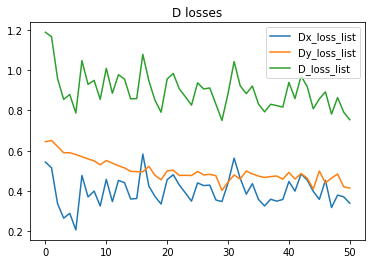

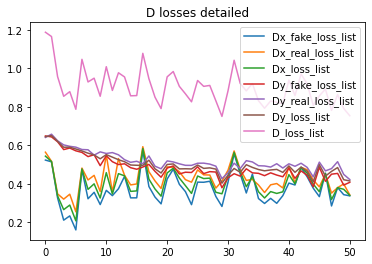

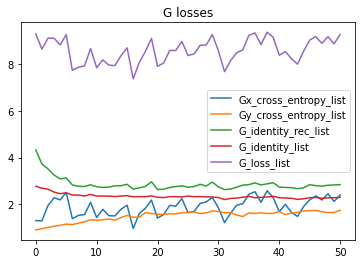

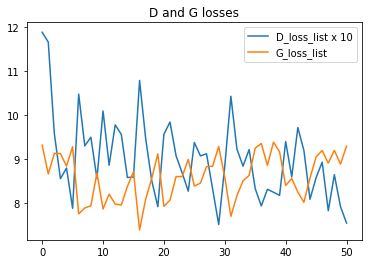

In [12]:
def plot_metrics():
    plt.title("D losses")
    plt.plot(Dx_loss_list, label='Dx_loss_list')
    plt.plot(Dy_loss_list, label='Dy_loss_list')
    plt.plot(D_loss_list, label='D_loss_list')
    plt.legend()
    plt.show()

    plt.title("D losses detailed")
    plt.plot(Dx_fake_loss_list, label='Dx_fake_loss_list')
    plt.plot(Dx_real_loss_list, label='Dx_real_loss_list')
    plt.plot(Dx_loss_list, label='Dx_loss_list')
    plt.plot(Dy_fake_loss_list, label='Dy_fake_loss_list')
    plt.plot(Dy_real_loss_list, label='Dy_real_loss_list')
    plt.plot(Dy_loss_list, label='Dy_loss_list')
    plt.plot(D_loss_list, label='D_loss_list')
    plt.legend()
    plt.show()

    plt.title("G losses")
    plt.plot(Gx_cross_entropy_list, label='Gx_cross_entropy_list')
    plt.plot(Gy_cross_entropy_list, label='Gy_cross_entropy_list')
    plt.plot(G_identity_rec_list, label='G_identity_rec_list')
    plt.plot(G_identity_list, label='G_identity_list')
    plt.plot(G_loss_list, label='G_loss_list')
    plt.legend()
    plt.show()

    plt.title("D and G losses")
    plt.plot(np.array(D_loss_list)*10, label='D_loss_list x 10')
    plt.plot(G_loss_list, label='G_loss_list')
    plt.legend()
    plt.show()

plot_metrics()

I tried to implement pix2pix and CycleGAN as close to the corresponding articles as I could. 

pix2pix losses decrease good and, according to validation pictures, reconstruction improves. Even though CycleGAN's losses do not fall a lot, the reconstruction images are quite good and detailed.